In [1]:
# pull from bin. make roc. loop roc over many m,n,rssi
# data labeling step is slow, as is fpr, tpr calculations

In [2]:
import glob
import os
import sys
import time
import datetime

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

from sklearn.metrics import roc_curve

from model import data_analysis
from model import en_convert
from plotly.subplots import make_subplots
DATA_PATH = 'C:/Users/etownsen/Documents/Jupyter Lab Notebooks/EmilyDec2020/FilteredData'
#DATA_PATH = '../data/calibration_20201103/'
#DATA_PATH = '../data/calibration/'
#DATA_PATH = '../data/calibration_some/'
#DATA_PATH = '../data/calibration_1/'
#DATA_PATH = 'Y:\calibration/'
#DATA_PATH = '../FilteredData/'
DATA_PATH

'C:/Users/etownsen/Documents/Jupyter Lab Notebooks/EmilyDec2020/FilteredData'

In [3]:
# variables to check/modify:
# n_pts (data removed at start & end of files)
# M,N of filter

In [4]:
# open multiple data and process as one set
all_files = glob.iglob(os.path.join(DATA_PATH, "*.bin"))
#list(all_files)

In [5]:
n_pts = 60
df_each_file = (data_analysis.load_cal_bin(f, n_pts) for f in all_files)
# note: load_cal_bin(f,n_pts) discards n_pts data points from the start and end of each file
# sometimes a data file includes more than one acquisition, so this should probably be cleaned up
# on import, checks that RSSI value is negative
#list(df_each_file) # THIS COMMAND BREAKS THE CONCAT BELOW
df_all = pd.concat(df_each_file, ignore_index=True)
df_all.tail()
df = df_all
#df.head()

C:/Users/etownsen/Documents/Jupyter Lab Notebooks/EmilyDec2020/FilteredData\9EAB51EBB73B_filtered_NIST1081_20201103_162744_GMT_BL2p0.bin
['BL2p0', 'bin']
['B', 'L', '2', 'p', '0'] BL
C:/Users/etownsen/Documents/Jupyter Lab Notebooks/EmilyDec2020/FilteredData\closest_filtered_NIST0031_20201007_194816_GMT_BL2p0.bin
['BL2p0', 'bin']
['B', 'L', '2', 'p', '0'] BL
C:/Users/etownsen/Documents/Jupyter Lab Notebooks/EmilyDec2020/FilteredData\closest_filtered_NIST0031_20201007_200210_GMT_BL1p5.bin
['BL1p5', 'bin']
['B', 'L', '1', 'p', '5'] BL
C:/Users/etownsen/Documents/Jupyter Lab Notebooks/EmilyDec2020/FilteredData\closest_filtered_NIST0031_20201007_201745_GMT_BL1p0.bin
['BL1p0', 'bin']
['B', 'L', '1', 'p', '0'] BL
C:/Users/etownsen/Documents/Jupyter Lab Notebooks/EmilyDec2020/FilteredData\closest_filtered_NIST0032_20201007_194855_GMT_BL2p0.bin
['BL2p0', 'bin']
['B', 'L', '2', 'p', '0'] BL
C:/Users/etownsen/Documents/Jupyter Lab Notebooks/EmilyDec2020/FilteredData\closest_filtered_NIST0032_202

In [6]:
df.mac.value_counts()

86b7ab79e434    14721
06dde160ca21    11245
571fde4d2512     9578
9eab51ebb73b     8502
e470dd083625     8150
753797df2129     7683
c0b361aca12b     7379
2b8156187b0c     6174
695cd608bd0f     6038
a21cc526ac21     5721
14e644022f25     5366
f816ba8cef33     5069
e01871f67c2f     4957
0a0fc2189c32     4625
6dd7bd831026     4622
e0b3bd9dc42e     4260
e963f6670827     3962
d8c386db6739     3814
a019a8194e11     3782
825c4e028828     3607
8d8f22818721     3175
97abab800c23     3158
71cbcab01b22     2660
ac5a194a5f17     2404
a55c7e12ba1e     1758
29db6477ff38     1702
b4f42d65ef05     1354
2254163b9434      501
0797eb636a10      395
Name: mac, dtype: int64

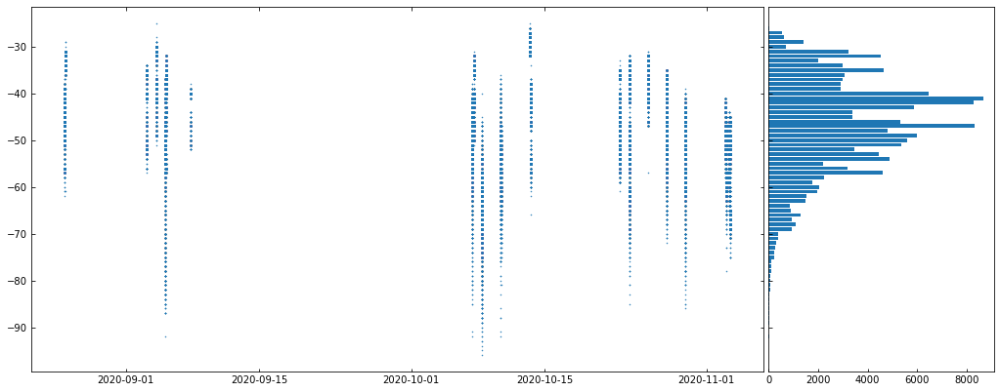

In [7]:
figure = data_analysis.plot_rssi(df['time'], df['rssi'])
# add axes labels
plt.show()

In [8]:
[unique_ids,unique_counts] = data_analysis.get_unique(df)
unique_ids

array(['06dde160ca21', '0797eb636a10', '0a0fc2189c32', '14e644022f25',
       '2254163b9434', '29db6477ff38', '2b8156187b0c', '571fde4d2512',
       '695cd608bd0f', '6dd7bd831026', '71cbcab01b22', '753797df2129',
       '825c4e028828', '86b7ab79e434', '8d8f22818721', '97abab800c23',
       '9eab51ebb73b', 'a019a8194e11', 'a21cc526ac21', 'a55c7e12ba1e',
       'ac5a194a5f17', 'b4f42d65ef05', 'c0b361aca12b', 'd8c386db6739',
       'e01871f67c2f', 'e0b3bd9dc42e', 'e470dd083625', 'e963f6670827',
       'f816ba8cef33'], dtype=object)

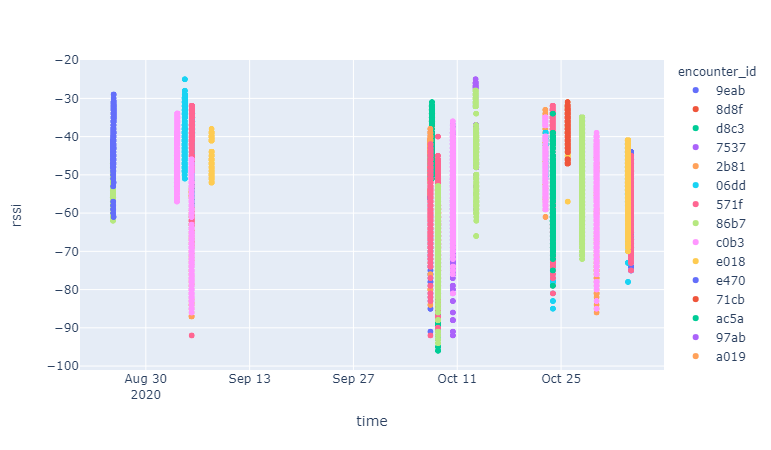

In [9]:
figure = data_analysis.plot_data_check(df)
figure.show()

In [10]:
# select either df.distance_fname or df.distance_header
df['distance'] = df['distance_fname']
# labels the data with true positive < 200
df = data_analysis.label_cal_data(df)
df.head()

,device_time,mac,rssi,ch,epochtime,offsettime,offsetovflw,distance_header,distance_fname,cal_config,orientation,encounter_id,time,source_filename,distance,encounter_label
0,474496665.0,9eab51ebb73b,-53.0,-39.0,1604420009,474470196,3,200,200.0,BL,0,9eab51ebb73b,2020-11-03 10:13:55,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0
1,474496872.0,9eab51ebb73b,-51.0,-37.0,1604420009,474470196,3,200,200.0,BL,0,9eab51ebb73b,2020-11-03 10:13:55,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0
2,474497082.0,9eab51ebb73b,-51.0,-38.0,1604420009,474470196,3,200,200.0,BL,0,9eab51ebb73b,2020-11-03 10:13:55,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0
3,474497292.0,9eab51ebb73b,-52.0,-39.0,1604420009,474470196,3,200,200.0,BL,0,9eab51ebb73b,2020-11-03 10:13:56,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0
4,474497503.0,9eab51ebb73b,-50.0,-37.0,1604420009,474470196,3,200,200.0,BL,0,9eab51ebb73b,2020-11-03 10:13:56,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0


In [11]:
df=df.sort_values(by='time', inplace=False, ascending=True)
df_all = df

In [12]:
len(df)

146362

In [13]:
df = df_all
# could select a single channel here:
df = df[df["ch"] == -38].reset_index()
df.head()

,index,device_time,mac,rssi,ch,epochtime,offsettime,offsetovflw,distance_header,distance_fname,cal_config,orientation,encounter_id,time,source_filename,distance,encounter_label
0,57494,36004866.0,86b7ab79e434,-50.0,-38.0,1602643321,4294966525,0,200,200.0,BL,0,86b7ab79e434,2020-08-25 13:39:19,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0
1,57497,36005495.0,86b7ab79e434,-50.0,-38.0,1602643321,4294966525,0,200,200.0,BL,0,86b7ab79e434,2020-08-25 13:39:19,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0
2,57500,36006125.0,86b7ab79e434,-50.0,-38.0,1602643321,4294966525,0,200,200.0,BL,0,86b7ab79e434,2020-08-25 13:39:20,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0
3,57506,36007372.0,86b7ab79e434,-49.0,-38.0,1602643321,4294966525,0,200,200.0,BL,0,86b7ab79e434,2020-08-25 13:39:21,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0
4,57503,36006759.0,86b7ab79e434,-49.0,-38.0,1602643321,4294966525,0,200,200.0,BL,0,86b7ab79e434,2020-08-25 13:39:21,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0


In [14]:
WINDOW_SIZE = 6
REQD_READINGS = 2
CLOSE_LEVEL = -60

data_analysis.find_gaps(df)

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



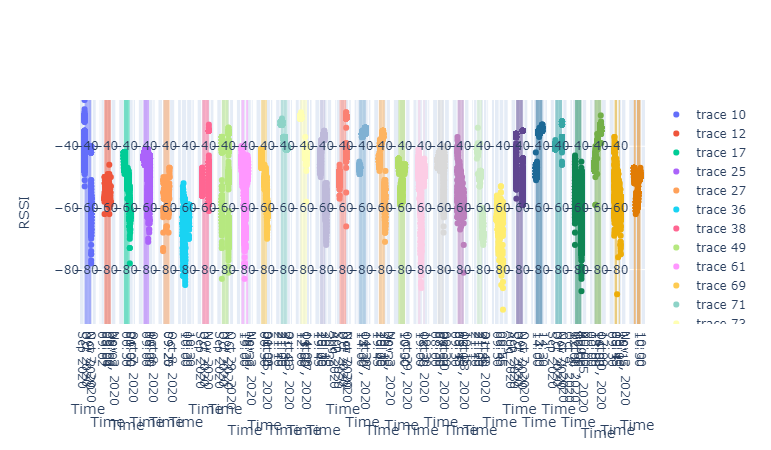

In [15]:
fig = make_subplots(rows=1, cols=data_analysis.count_traces(df)) #, shared_yaxes=True
ylim0 = 1.05*min(df['rssi'])
ylim1 = max(df['rssi'])
fig.update_xaxes(title_text = "Time")
fig.update_yaxes(title_text = "RSSI", row=1, col=1)
fig.update_yaxes(range=[ylim0, ylim1])
figcolors = px.colors.qualitative.Plotly
figcolors.extend(px.colors.qualitative.Set3)
figcolors.extend(px.colors.qualitative.Prism)

data_analysis.plot_these_traces(df, fig, WINDOW_SIZE, REQD_READINGS, CLOSE_LEVEL, ylim0, ylim1, figcolors)

In [16]:
np.unique(df[df['mac']==unique_ids[13]]['distance'])

array([ 50., 150., 200., 250.])

In [17]:
df[0:1]

,index,device_time,mac,rssi,ch,epochtime,offsettime,offsetovflw,distance_header,distance_fname,cal_config,orientation,encounter_id,time,source_filename,distance,encounter_label,count,eid_index,trace
0,57494,36004866.0,86b7ab79e434,-50.0,-38.0,1602643321,4294966525,0,200,200.0,BL,0,86b7ab79e434,2020-08-25 13:39:19,C:/Users/etownsen/Documents/Jupyter Lab Notebo...,200.0,0,2.0,13.0,86b7_2.0


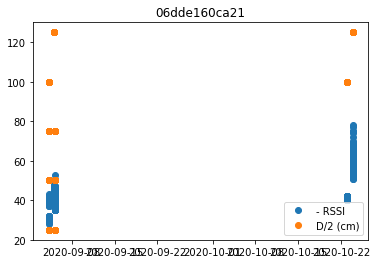

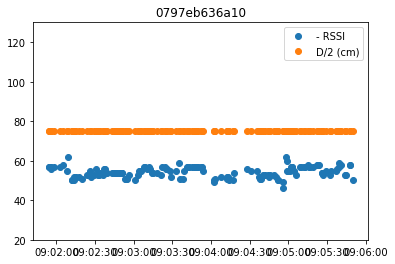

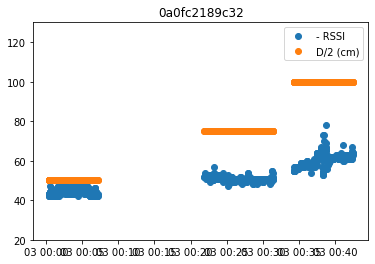

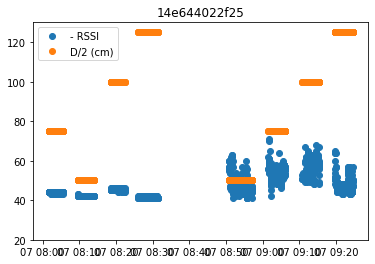

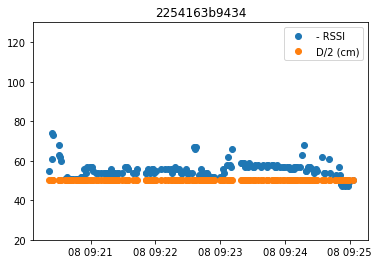

...

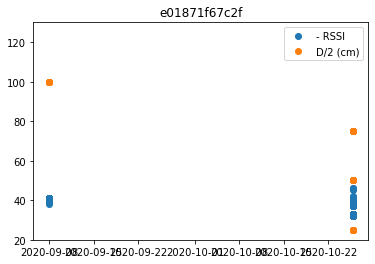

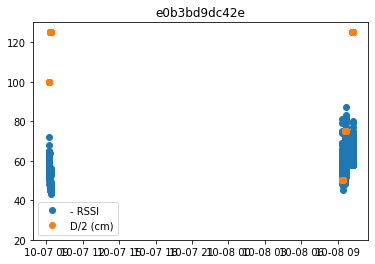

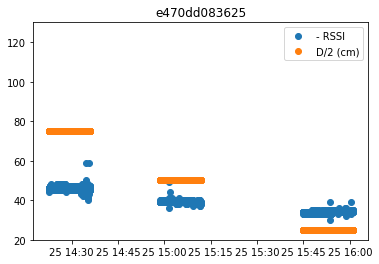

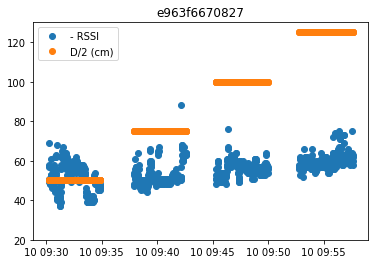

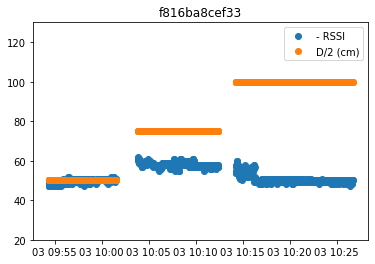

In [18]:
df['dist/2'] = 0.5*df.distance
df['-1*rssi']= -1*df.rssi
for id in unique_ids[:]:
    temp1 = df[df['mac']==id]['time']
    temp2 =df[df['mac']==id]['-1*rssi']
    plt.plot(temp1,temp2,'o', label='- RSSI')
    plt.plot(temp1, df[df['mac']==id]['dist/2'],'o', label='D/2 (cm)')
    #plt.title(f"distance: {dist}, Devices: {Aname, Bname}, Config: {Config}")
    plt.title(id)
    plt.legend()
    plt.ylim((20, 130))
    filename="Figures/RSSIandDist%s.jpg"% (id)
    #    filename="RSSI%s%sConf%sDist%s.jpg"% (Aname, Bname, Config, dist)
    plt.savefig(filename)
    plt.pause(0.01)
print()            
#plt.plot(d[idx]['time'], d[idx]['rssi'],'o', label=mac_b)

In [19]:
fpr, tpr, data_check = data_analysis.roc_these_traces(df, WINDOW_SIZE, REQD_READINGS)

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



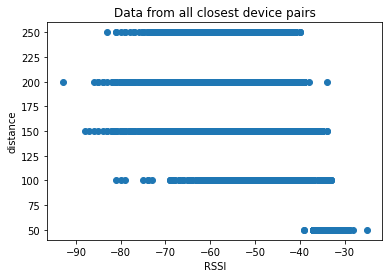

In [20]:
plt.scatter(df.rssi, df.distance)
plt.title('Data from all closest device pairs')
plt.ylabel('distance')
plt.xlabel('RSSI')
output_filename='Figures/DistancevsRSSI.jpg'
plt.savefig(output_filename)

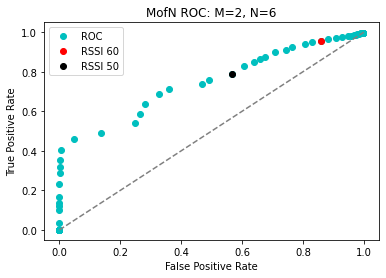

In [21]:
output_filename="Figures/ROCCurveWindow%sReads%s.jpg"% (WINDOW_SIZE, REQD_READINGS)

fig=data_analysis.plot_roc_curve_return_fig(fpr, tpr, 50, 60, WINDOW_SIZE, REQD_READINGS)
fig.savefig(output_filename)

In [22]:
fig

<function matplotlib.pyplot.figure(num=None, figsize=None, dpi=None, facecolor=None, edgecolor=None, frameon=True, FigureClass=<class 'matplotlib.figure.Figure'>, clear=False, **kwargs)>

In [23]:
data_check

0.6494403429387949

In [24]:
tpr

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 1.70108529e-04, 3.25247508e-02,
       1.02507400e-01, 1.20538904e-01, 1.34555847e-01, 1.68713639e-01,
       2.32742490e-01, 2.88640152e-01, 3.18205015e-01, 3.52226721e-01,
       4.04518083e-01, 4.59531181e-01, 4.87837240e-01, 5.39924472e-01,
       5.86704317e-01, 6.36716225e-01, 6.87544653e-01, 7.15170279e-01,
       7.39938080e-01, 7.57119042e-01, 7.86990100e-01, 8.30469840e-01,
       8.51393189e-01, 8.64015242e-01, 8.76331099e-01, 8.97934882e-01,
      

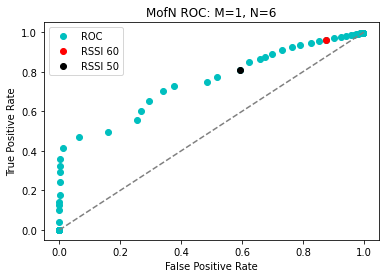

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



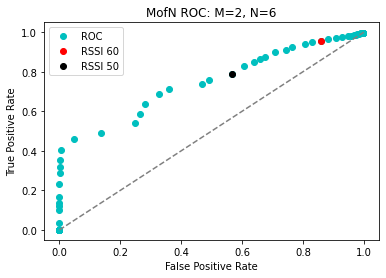

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



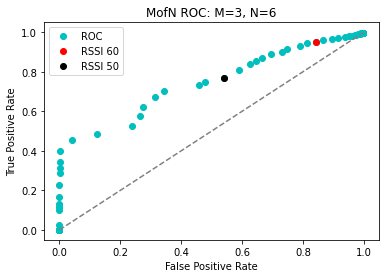

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



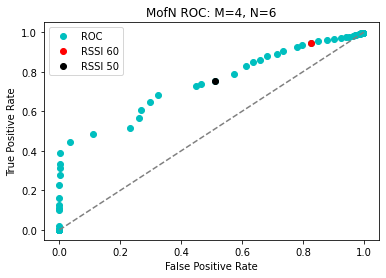

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



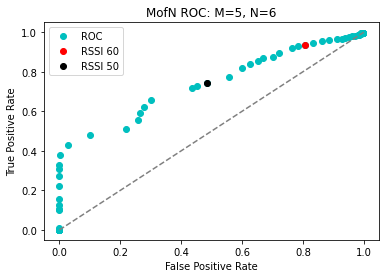

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



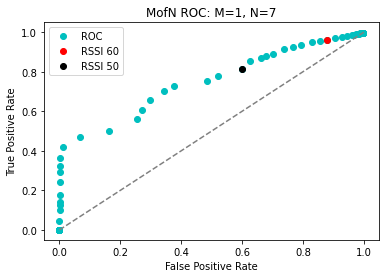

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



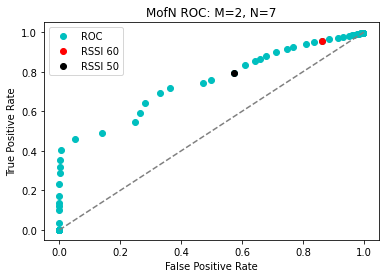

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



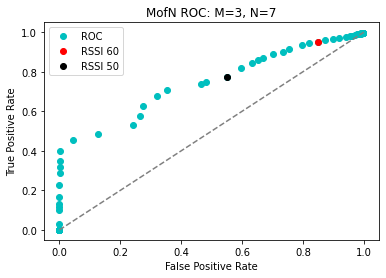

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



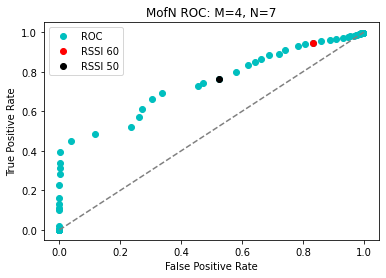

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



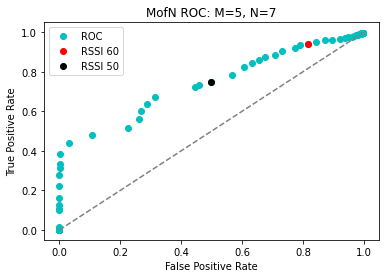

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



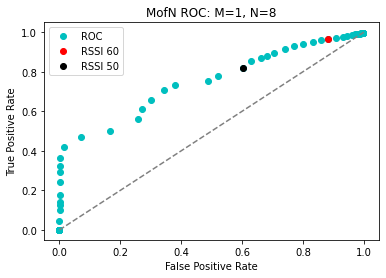

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



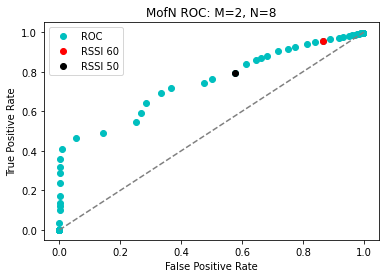

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



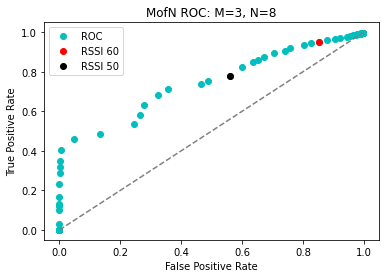

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



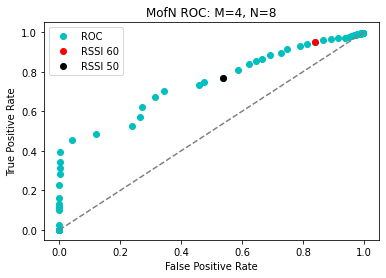

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



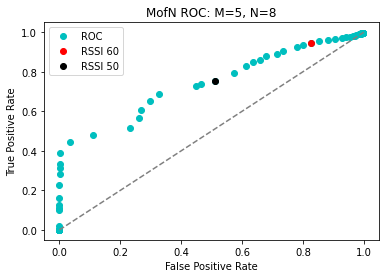

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



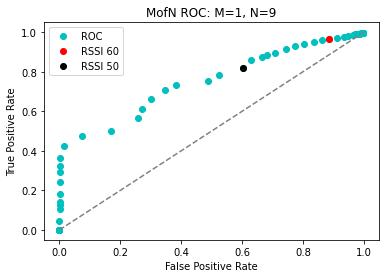

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



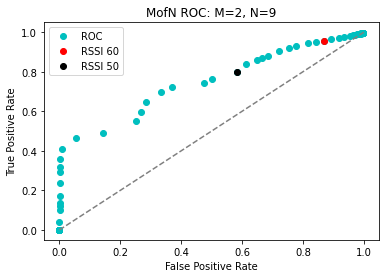

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



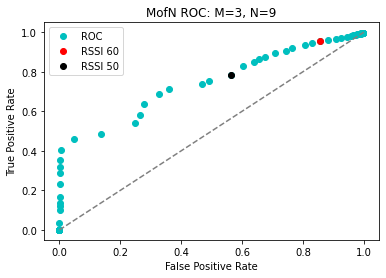

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



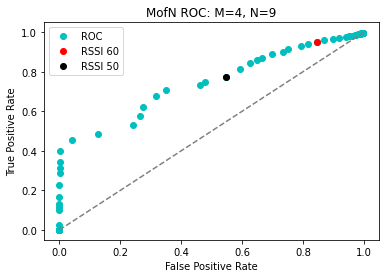

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



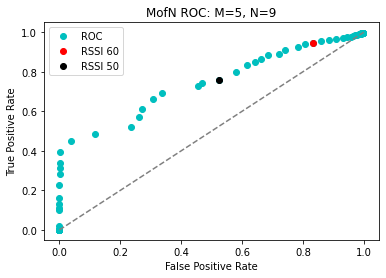

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



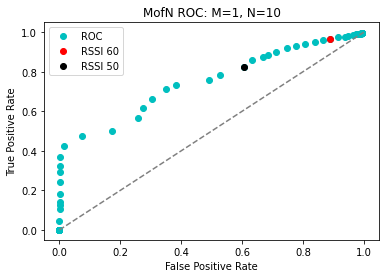

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



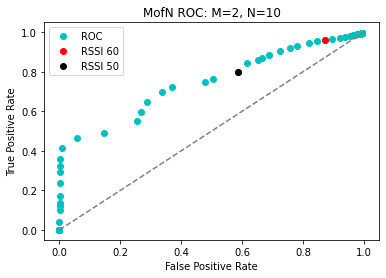

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



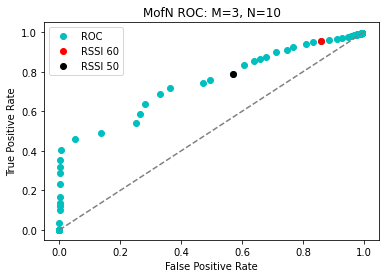

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



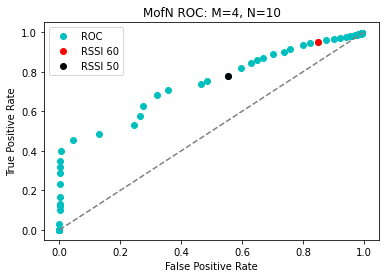

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



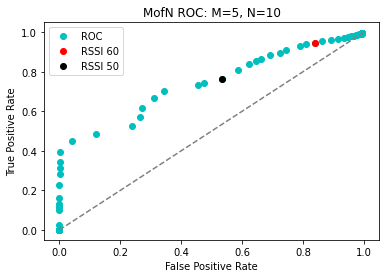

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



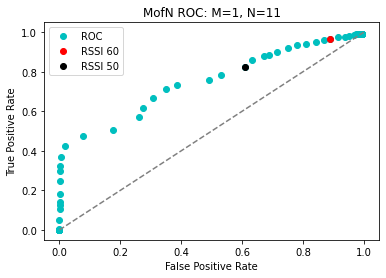

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



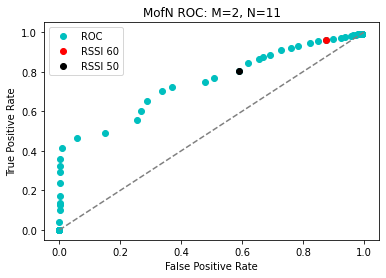

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



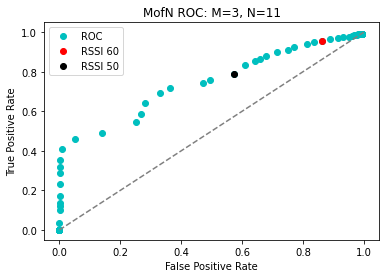

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



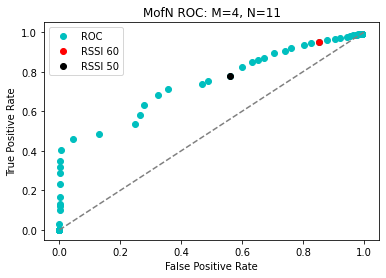

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



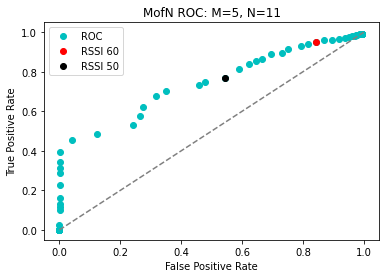

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



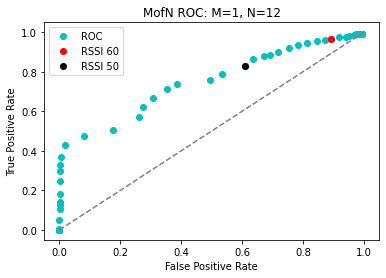

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



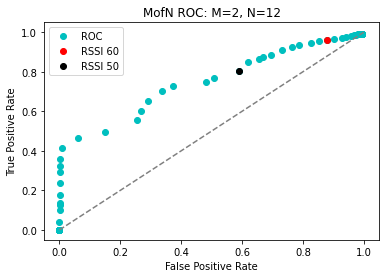

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



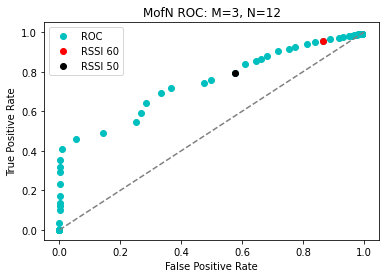

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



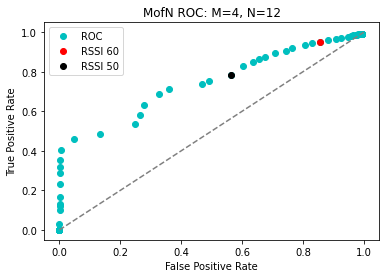

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



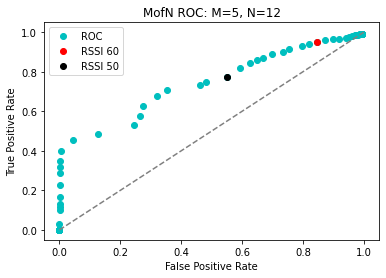

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



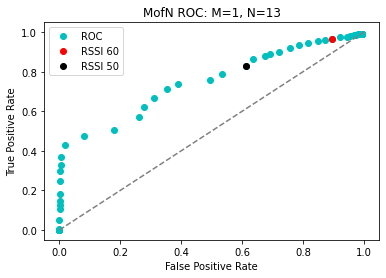

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



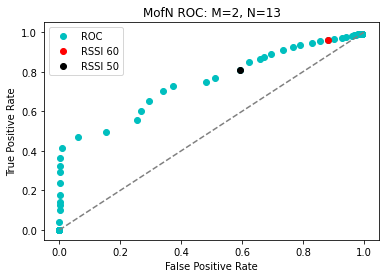

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



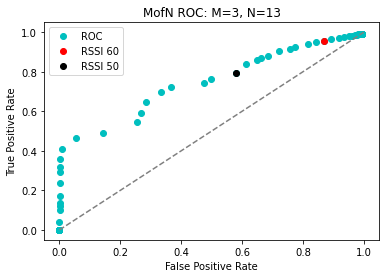

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



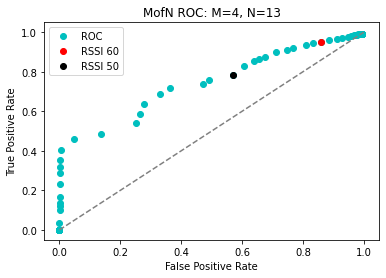

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



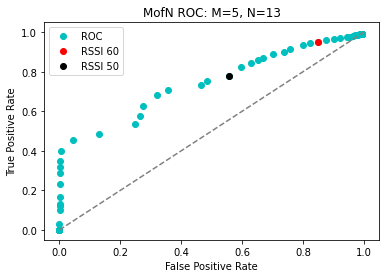

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



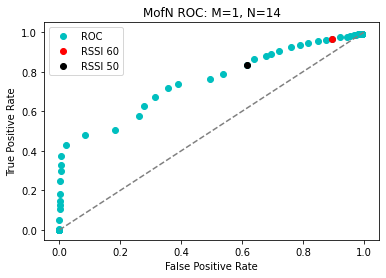

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



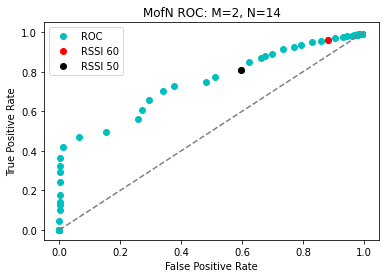

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



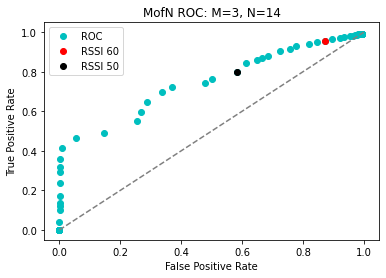

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:845: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\etownsen\Anaconda3\lib\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
for WINDOW_SIZE in range(6,21):
    for REQD_READINGS in range(1,6):
        fpr, tpr, data_check = data_analysis.roc_these_traces(df, WINDOW_SIZE, REQD_READINGS)
        output_filename="Figures/ROCCurveWindow%sReads%s.jpg"% (WINDOW_SIZE, REQD_READINGS)
        fig=data_analysis.plot_roc_curve_return_fig(fpr, tpr, 50, 60, WINDOW_SIZE, REQD_READINGS)
        fig.savefig(output_filename)

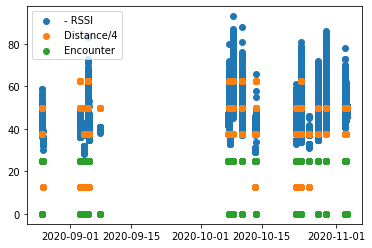

In [72]:
myfig = plt.figure()
new_plot = myfig.add_subplot(111)
new_plot= plt.scatter(df.time,-1*df.rssi, label="- RSSI")
plt.scatter(df.time,(0.25*df.distance), label="Distance/4")
plt.scatter(df.time,25*df.encounter_label, label="Encounter")
plt.legend()


In [ ]:
ax1 = plt.subplot(111)
ax1.scatter(df.time,-1*df.rssi, label="- RSSI" )
  #fig = px.scatter(df, x="time", y="rssi", color="encounter_id", hover_data=["close encounter"])
ax1.scatter(df.time,(0.25*df.distance), label="Distance/4")
ax1.scatter(df.time,25*df.encounter_label, label="25*Encounter")
ax1.legend()
ax1.get_xlim()
ax1.set_xlim([737705.33, 737705.4])

In [ ]:
df['dist/4'] = 0.25*df.distance
df['-1*rssi']= -1*df.rssi

In [ ]:
#fig = px.scatter(df, x="time", y=["-1*rssi","dist/4"], color="encounter_id")
##fig.add_scatter(x=df.time, y=df.distance).
#fig.show()

In [ ]:
fig = px.scatter(df, x="time", y="-1*rssi", color="encounter_id")
fig2 = px.scatter(df, x="time", y="dist/4")
fig2.update_traces(marker=dict(line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
fig.add_trace(fig2.data[0])
#fig.add_scatter(x=df.time, y=df.distance).
fig.show()
#layout = go.Layout(xaxis=dict(range=[737705.33, 737705.4]))
#fig.update_layout(xaxis=dict(range=[737705.33, 737705.4]))#[fromValue,toValue]))

In [ ]:
s=df.groupby('encounter_id')#.agg(["rssi","mean"])
s.agg(["rssi","mean"]).head()

In [ ]:
df.mac.value_counts()

In [ ]:
df.loc[df['mac']=='d8c386db6739','source_filename'] 

In [ ]:
 i = 0
for eid, df_eid in df.groupby('encounter_id'):
    df_eid.loc[:,('AvgRSSI')]=df_eid['rssi'].mean()

In [ ]:
#    s=df_eid
 #   t=s.sort_values(by='AvgRSSI')
    #sorted(df_eid['sum'])   sample_data.sort_values(by='sepal_width')
#    df.sort_values(by='SumRSSI').index.values#, ascending=False)
# print(df_eid.AvgRSSI)
print(df_eid)
for source, df_source in df.groupby('source_filename')
    s= df_source.sort_values(by=AvgRSSI)
print(df)

In [ ]:
df

In [ ]:
for eid, df_eid in df.groupby('encounter_id'):
    df.loc[:,('AvgRSSI')]=df_eid['rssi'].mean()
 #s = df.groupby('encounter_id').rating.agg(['count', 'mean'])

grouped = df.groupby('source_filename')
for source, group in grouped:
    print(source)
   # s=group.sort_values(by='AvgRSSI') pd.Series(df['Age'].unique()).nsmallest(2)
    s = pd.Series(group['AvgRSSI'].unique()).nlargest(2)
#    s=group.nsmallest(2, 'AvgRSSI')
    print(s)

In [ ]:
df